### Проект классификация

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import seaborn as sns
import matplotlib

# Clustering algorithm
from sklearn.cluster import AgglomerativeClustering

# Rand Index
from sklearn.metrics.cluster import rand_score

# Encode labels
from sklearn import preprocessing

# Confusion Matrix
from sklearn.metrics import confusion_matrix

In [3]:
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier

In [4]:
#  Рабочая папка
import os
os.chdir("C:/Users/Екатерина/Desktop/my fale/учеба/4 курс/Проекты аналитики данных/Классификация")

In [5]:
# загружаем данные из csv файла
data = pd.read_csv('DatasetAdults.csv',delimiter=';')
# информация о датасете
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24279 entries, 0 to 24278
Data columns (total 15 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   age             24279 non-null  int64 
 1   workclass       24279 non-null  object
 2   fnlwgt          24279 non-null  int64 
 3   education       24279 non-null  object
 4   education-num   24279 non-null  int64 
 5   marital-status  24279 non-null  object
 6   occupation      24279 non-null  object
 7   relationship    24279 non-null  object
 8   race            24279 non-null  object
 9   sex             24279 non-null  object
 10  capital-gain    24279 non-null  int64 
 11  capital-loss    24279 non-null  int64 
 12  hours-per-week  24279 non-null  int64 
 13  native-country  24279 non-null  object
 14  y               24279 non-null  object
dtypes: int64(6), object(9)
memory usage: 2.8+ MB


In [6]:
data.head()

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,y
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K


In [7]:
data.describe()

,age,fnlwgt,education-num,capital-gain,capital-loss,hours-per-week
count,24279.000000,2.427900e+04,24279.000000,24279.000000,24279.000000,24279.000000
mean,38.601219,1.899193e+05,10.082417,1076.750772,85.930187,40.408584
std,13.688196,1.054896e+05,2.558582,7396.913001,400.015050,12.313853
min,17.000000,1.228500e+04,1.000000,0.000000,0.000000,1.000000
25%,28.000000,1.179920e+05,9.000000,0.000000,0.000000,40.000000
50%,37.000000,1.784690e+05,10.000000,0.000000,0.000000,40.000000
75%,48.000000,2.374535e+05,12.000000,0.000000,0.000000,45.000000
max,90.000000,1.484705e+06,16.000000,99999.000000,4356.000000,99.000000


In [8]:
#удаляем строки, содержащие нулевые значения
data=data.dropna()
data

,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,y
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24274,67,Self-emp-not-inc,123393,HS-grad,9,Married-civ-spouse,Transport-moving,Husband,White,Male,6418,0,58,United-States,>50K
24275,26,Private,159732,HS-grad,9,Widowed,Transport-moving,Not-in-family,White,Male,0,0,40,United-States,<=50K
24276,21,Private,161415,Some-college,10,Never-married,Craft-repair,Not-in-family,White,Male,0,0,50,United-States,<=50K
24277,33,Private,157568,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,<=50K


In [9]:
data.dtypes

age                int64
workclass         object
fnlwgt             int64
education         object
education-num      int64
marital-status    object
occupation        object
relationship      object
race              object
sex               object
capital-gain       int64
capital-loss       int64
hours-per-week     int64
native-country    object
y                 object
dtype: object

In [10]:
data.nunique()

age                  72
workclass             9
fnlwgt            17443
education            16
education-num        16
marital-status        7
occupation           15
relationship          6
race                  5
sex                   2
capital-gain        117
capital-loss         88
hours-per-week       93
native-country       42
y                     2
dtype: int64

У нас получается бинарные переменные только sex и y

In [11]:
data['workclass'].value_counts()

 Private             16865
 Self-emp-not-inc     1926
 Local-gov            1586
 ?                    1360
 State-gov             962
 Self-emp-inc          833
 Federal-gov           734
 Without-pay             8
 Never-worked            5
Name: workclass, dtype: int64

In [12]:
data['occupation'].value_counts()

 Prof-specialty       3089
 Craft-repair         3037
 Exec-managerial      2994
 Adm-clerical         2884
 Sales                2730
 Other-service        2469
 Machine-op-inspct    1496
 ?                    1365
 Transport-moving     1196
 Handlers-cleaners     976
 Farming-fishing       747
 Tech-support          682
 Protective-serv       487
 Priv-house-serv       120
 Armed-Forces            7
Name: occupation, dtype: int64

In [13]:
data['native-country'].value_counts()

 United-States                 21766
 Mexico                          470
 ?                               431
 Philippines                     148
 Germany                          99
 Canada                           97
 Puerto-Rico                      95
 Cuba                             72
 England                          71
 El-Salvador                      71
 India                            65
 South                            63
 China                            58
 Jamaica                          56
 Italy                            54
 Dominican-Republic               53
 Vietnam                          50
 Guatemala                        50
 Poland                           49
 Japan                            46
 Taiwan                           42
 Columbia                         42
 Haiti                            37
 Iran                             35
 Portugal                         28
 Nicaragua                        24
 Greece                           23
 

Как мы видим у нас есть столбцы со значениями ?

Первый способ это удалить эти значения, второй способ это выделить их как класс

In [14]:
#удаляем строки, содержащие нулевые значения
data.replace(' ?', pd.np.nan, inplace=True)
data = data.dropna()
data

C:\Users\Екатерина\AppData\Local\Temp\ipykernel_12480\2735379042.py:2: FutureWarning: The pandas.np module is deprecated and will be removed from pandas in a future version. Import numpy directly instead.
  data.replace(' ?', pd.np.nan, inplace=True)


,age,workclass,fnlwgt,education,education-num,marital-status,occupation,relationship,race,sex,capital-gain,capital-loss,hours-per-week,native-country,y
0,39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
1,50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
2,38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
3,53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
4,28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24274,67,Self-emp-not-inc,123393,HS-grad,9,Married-civ-spouse,Transport-moving,Husband,White,Male,6418,0,58,United-States,>50K
24275,26,Private,159732,HS-grad,9,Widowed,Transport-moving,Not-in-family,White,Male,0,0,40,United-States,<=50K
24276,21,Private,161415,Some-college,10,Never-married,Craft-repair,Not-in-family,White,Male,0,0,50,United-States,<=50K
24277,33,Private,157568,HS-grad,9,Married-civ-spouse,Machine-op-inspct,Husband,White,Male,0,0,40,United-States,<=50K


Далее проведем стандартизацию на численные переменные, поэтому мы делаем это до one-hot encoding

In [1]:
# Стандартизация переменных
from sklearn.preprocessing import scale,RobustScaler,StandardScaler, MinMaxScaler
scaler = preprocessing.StandardScaler()
scaler.fit(data.select_dtypes(include='number'))
numerical_data1 = scaler.transform(data.select_dtypes(include='number'))
numerical_data1 = pd.DataFrame(numerical_data1, index=data.index, columns=['age_st','fnlwgt_st','education-num_st','capital-gain_st','capital-loss_st','hours-per-week_st'])
data = pd.concat([data, numerical_data1], axis = 1)


KeyboardInterrupt



In [16]:
data.drop(['age','fnlwgt','education-num','capital-gain','capital-loss','hours-per-week'], axis= 1 , inplace= True )
data.head(5)

,workclass,education,marital-status,occupation,relationship,race,sex,native-country,y,age_st,fnlwgt_st,education-num_st,capital-gain_st,capital-loss_st,hours-per-week_st
0,State-gov,Bachelors,Never-married,Adm-clerical,Not-in-family,White,Male,United-States,<=50K,0.039556,-1.064446,1.135566,0.147504,-0.217055,-0.076483
1,Self-emp-not-inc,Bachelors,Married-civ-spouse,Exec-managerial,Husband,White,Male,United-States,<=50K,0.873015,-1.009554,1.135566,-0.146708,-0.217055,-2.335254
2,Private,HS-grad,Divorced,Handlers-cleaners,Not-in-family,White,Male,United-States,<=50K,-0.036213,0.243981,-0.443549,-0.146708,-0.217055,-0.076483
3,Private,11th,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,United-States,<=50K,1.100322,0.424667,-1.233107,-0.146708,-0.217055,-0.076483
4,Private,Bachelors,Married-civ-spouse,Prof-specialty,Wife,Black,Female,Cuba,<=50K,-0.793903,1.406845,1.135566,-0.146708,-0.217055,-0.076483


Далее делаем процедуру one-hot encoding

In [17]:
from sklearn.preprocessing import OneHotEncoder
oenc=OneHotEncoder()
multiple_enc=oenc.fit_transform(data[['workclass','education','marital-status','occupation','relationship','race','native-country']])# onehotencoding on 3 features

multiple_enc=multiple_enc.toarray()

#oenc.get_feature_names() use this method to get column names
multiple_enc=pd.DataFrame(multiple_enc,columns=oenc.get_feature_names_out())

data=pd.concat([data,multiple_enc],axis=1) # append to original dataframe

In [18]:
data.head(5)

,workclass,education,marital-status,occupation,relationship,race,sex,native-country,y,age_st,...,native-country_ Portugal,native-country_ Puerto-Rico,native-country_ Scotland,native-country_ South,native-country_ Taiwan,native-country_ Thailand,native-country_ Trinadad&Tobago,native-country_ United-States,native-country_ Vietnam,native-country_ Yugoslavia
0,State-gov,Bachelors,Never-married,Adm-clerical,Not-in-family,White,Male,United-States,<=50K,0.039556,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,Self-emp-not-inc,Bachelors,Married-civ-spouse,Exec-managerial,Husband,White,Male,United-States,<=50K,0.873015,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,Private,HS-grad,Divorced,Handlers-cleaners,Not-in-family,White,Male,United-States,<=50K,-0.036213,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,Private,11th,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,United-States,<=50K,1.100322,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,Private,Bachelors,Married-civ-spouse,Prof-specialty,Wife,Black,Female,Cuba,<=50K,-0.793903,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [19]:
data.drop(['workclass','education','marital-status','occupation','relationship','race','native-country'], axis= 1 , inplace= True )
data.head(5)

,sex,y,age_st,fnlwgt_st,education-num_st,capital-gain_st,capital-loss_st,hours-per-week_st,workclass_ Federal-gov,workclass_ Local-gov,...,native-country_ Portugal,native-country_ Puerto-Rico,native-country_ Scotland,native-country_ South,native-country_ Taiwan,native-country_ Thailand,native-country_ Trinadad&Tobago,native-country_ United-States,native-country_ Vietnam,native-country_ Yugoslavia
0,Male,<=50K,0.039556,-1.064446,1.135566,0.147504,-0.217055,-0.076483,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,Male,<=50K,0.873015,-1.009554,1.135566,-0.146708,-0.217055,-2.335254,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,Male,<=50K,-0.036213,0.243981,-0.443549,-0.146708,-0.217055,-0.076483,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,Male,<=50K,1.100322,0.424667,-1.233107,-0.146708,-0.217055,-0.076483,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,Female,<=50K,-0.793903,1.406845,1.135566,-0.146708,-0.217055,-0.076483,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Перекодирование бинарных переменных


In [20]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
data['sex'] = le.fit_transform(data['sex'])
data['y'] = le.fit_transform(data['y'])

In [21]:
data.head(5)

,sex,y,age_st,fnlwgt_st,education-num_st,capital-gain_st,capital-loss_st,hours-per-week_st,workclass_ Federal-gov,workclass_ Local-gov,...,native-country_ Portugal,native-country_ Puerto-Rico,native-country_ Scotland,native-country_ South,native-country_ Taiwan,native-country_ Thailand,native-country_ Trinadad&Tobago,native-country_ United-States,native-country_ Vietnam,native-country_ Yugoslavia
0,1,0,0.039556,-1.064446,1.135566,0.147504,-0.217055,-0.076483,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,1,0,0.873015,-1.009554,1.135566,-0.146708,-0.217055,-2.335254,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,1,0,-0.036213,0.243981,-0.443549,-0.146708,-0.217055,-0.076483,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,1,0,1.100322,0.424667,-1.233107,-0.146708,-0.217055,-0.076483,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0,0,-0.793903,1.406845,1.135566,-0.146708,-0.217055,-0.076483,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [22]:
#remove rows with any values that are not finite
data = data[np.isfinite(data).all(1)]

In [22]:
# Split the data into features (X) and target (y)
X = data.drop(["y"],axis=1)
y = data.y
X.head(5)

,sex,age_st,fnlwgt_st,education-num_st,capital-gain_st,capital-loss_st,hours-per-week_st,workclass_ Federal-gov,workclass_ Local-gov,workclass_ Private,...,native-country_ Portugal,native-country_ Puerto-Rico,native-country_ Scotland,native-country_ South,native-country_ Taiwan,native-country_ Thailand,native-country_ Trinadad&Tobago,native-country_ United-States,native-country_ Vietnam,native-country_ Yugoslavia
0,1,0.039556,-1.064446,1.135566,0.147504,-0.217055,-0.076483,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,1,0.873015,-1.009554,1.135566,-0.146708,-0.217055,-2.335254,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,1,-0.036213,0.243981,-0.443549,-0.146708,-0.217055,-0.076483,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,1,1.100322,0.424667,-1.233107,-0.146708,-0.217055,-0.076483,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0,-0.793903,1.406845,1.135566,-0.146708,-0.217055,-0.076483,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Алгоритм KNN

### Разбиение на обучающее и тестовое множества

In [23]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

In [24]:
# Scale the features using StandardScaler
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [25]:
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(15638, 103) (15638,)
(5213, 103) (5213,)


In [26]:
model = KNeighborsClassifier(n_neighbors=10, metric='euclidean') #'euclidean'
model.fit(X_train,y_train)

KNeighborsClassifier(metric='euclidean', n_neighbors=10)

In [27]:
y_pred = model.predict(X_test)

In [28]:
print("Прогнозы на тестовом наборе: {}".format(y_pred))

Прогнозы на тестовом наборе: [1 0 0 ... 0 0 0]


Оценки обобщающей способности модели:

In [29]:
print("Правильность на тестовом наборе: {:.2f}".format(model.score(X_test,y_test)))

Правильность на тестовом наборе: 0.78


In [30]:
y_test

12193    0
22126    0
14792    0
1609     0
6897     1
        ..
8250     0
12578    0
2773     0
19734    0
4237     0
Name: y, Length: 5213, dtype: int32

In [31]:
from sklearn.metrics import accuracy_score, balanced_accuracy_score, precision_score, recall_score

print('Accuracy: {:.2f}'.format(accuracy_score(y_test, y_pred), accuracy_score(y_test, y_pred, normalize=False)))

print('Precision: {:.2f}'.format(precision_score(y_test, y_pred)))

print('Recall: {:.2f}'.format(recall_score(y_test, y_pred)))

Accuracy: 0.78
Precision: 0.58
Recall: 0.14


### Использование перекрестной проверки для получения наилучшего значения k

Вместо разделения данных на обучающий и тестовый наборы, что уменьшает количество доступных для обучения данных, мы воспользуемся k-блочной перекрёстной проверкой (K-Fold Cross Validation). Для этого мы разделим обучающие данные на k блоков, а затем прогоним итеративный процесс, в ходе которого сначала обучим модель на k-1 блоках, а затем сравним результат при обучении на k-ом блоке. Будем повторять процесс k раз, и в конце получим среднее значение ошибки для каждой итерации. Это и будет финальная оценка.

In [32]:
from sklearn import datasets, linear_model
from sklearn.model_selection import cross_val_score
k_values = [i for i in range (1,31)]
scores = []

scaler = StandardScaler()
X = scaler.fit_transform(X)

for k in k_values:
    knn = KNeighborsClassifier(n_neighbors=k)
    score = cross_val_score(knn, X, y, cv=5)
    scores.append(np.mean(score))

Text(0, 0.5, 'Accuracy Score')

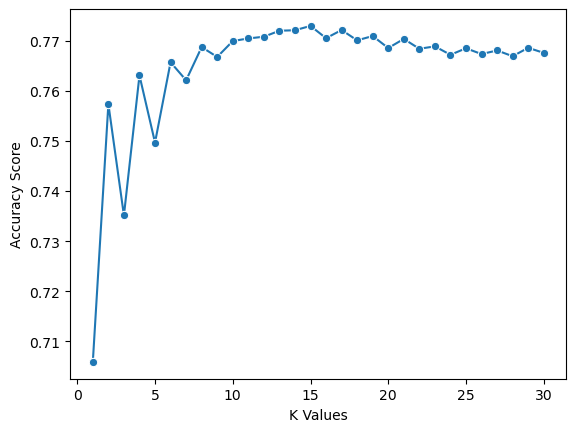

In [33]:
sns.lineplot(x = k_values, y = scores, marker = 'o')
plt.xlabel("K Values")
plt.ylabel("Accuracy Score")

Из нашей диаграммы мы видим, что k = 10, 11, 12 и 13 имеют показатель точности более 76%. Я бы сказала что самая высокая точность при k = 15

In [34]:
best_index = np.argmax(scores)
best_k = k_values[best_index]

knn = KNeighborsClassifier(n_neighbors=best_k)
knn.fit(X_train, y_train)

KNeighborsClassifier(n_neighbors=15)

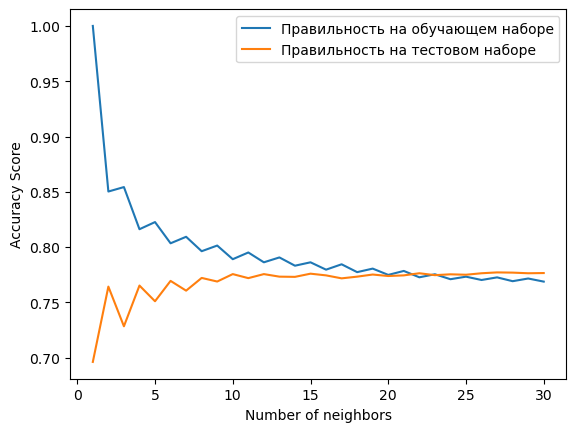

In [35]:
from sklearn import datasets, linear_model

  
training_accuracy = []
test_accuracy = []
neighbors_settings = [i for i in range (1,31)]

for n_neighbors in neighbors_settings:
    knn = KNeighborsClassifier(n_neighbors=n_neighbors)
    knn.fit(X_train, y_train)
    training_accuracy.append(knn.score(X_train,y_train))
    test_accuracy.append(knn.score(X_test,y_test))

plt.plot(neighbors_settings, training_accuracy, label="Правильность на обучающем наборе")
plt.plot(neighbors_settings, test_accuracy, label="Правильность на тестовом наборе")
plt.ylabel("Accuracy Score")
plt.xlabel("Number of neighbors")
plt.legend()

Думаю вариант с 10 соседями наиболее оптимальным можно считать

In [36]:
y_pred = knn.predict(X_test)

accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)

print("Accuracy: {:.2f}".format(accuracy))
print("Precision: {:.2f}".format(precision))
print("Recall: {:.2f}".format(recall))

Accuracy: 0.78
Precision: 0.72
Recall: 0.07


## Cross-validation

In [38]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold

model = KNeighborsClassifier(n_neighbors=10)

fold = KFold(n_splits=5, shuffle=True, random_state=5)

scores = cross_val_score(estimator = model,X=X_train, y=y_train,cv=fold)

In [39]:
print(scores)

[0.76150895 0.77557545 0.76662404 0.76271186 0.76399105]


In [40]:
print(scores.mean())

0.766082270007042


In [41]:
from sklearn.datasets import make_classification
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import MinMaxScaler

X, y = make_classification(random_state=42)
pipe = make_pipeline(MinMaxScaler(), KNeighborsClassifier(n_neighbors=5))
pipe.fit(X_train, y_train)  # стандартизация обучающего множества

pipe.score(X_test, y_test)  # применяем стандартизацию к тестовым данным без утечки обучающих данных

0.7488969882984846

## Decision Trees

In [42]:
from sklearn.tree import DecisionTreeClassifier

In [43]:
cl_tree = DecisionTreeClassifier(random_state = 0)
cl_tree.fit(X_train, y_train)
print("Правильность на обучающем наборе: {:.3f}".format(cl_tree.score(X_train,y_train)))
print("Правильность на тестовом наборе: {:.3f}".format(cl_tree.score(X_test,y_test)))

Правильность на обучающем наборе: 1.000
Правильность на тестовом наборе: 0.764


In [44]:
from sklearn.metrics import accuracy_score, balanced_accuracy_score
predictions = cl_tree.predict(X_test)
accuracy_score(predictions, y_test)

0.7644350661807021

Установим max_depth

In [45]:
cl_tree_param = DecisionTreeClassifier(max_depth=4, random_state=42)
cl_tree_param.fit(X_train, y_train)
print("Правильность на обучающем наборе: {:.3f}".format(cl_tree_param.score(X_train,y_train)))
print("Правильность на тестовом наборе: {:.3f}".format(cl_tree_param.score(X_test,y_test)))

Правильность на обучающем наборе: 0.821
Правильность на тестовом наборе: 0.831


In [46]:
predictions_param = cl_tree_param.predict(X_test)
accuracy_score(predictions_param, y_test)

0.8306157682716286

In [ ]:
#conda install -c conda-forge python-graphiz

In [47]:
pip install pydotplus==2.0.0

In [48]:
import pydotplus

#conda install -c anaconda pydotplus

In [49]:
pip install graphviz

Note: you may need to restart the kernel to use updated packages.


In [50]:
import graphviz

In [51]:
from sklearn import tree
from sklearn.tree import export_graphviz

In [52]:
from IPython.display import Image
dot_data = tree.export_graphviz(cl_tree,
                               out_file=None,
                               feature_names=None,
                               class_names=None)
graph = pydotplus.graph_from_dot_data(dot_data)

In [53]:
conda install graphviz

Retrieving notices: ...working... done
Solving environment: ...working... done

## Package Plan ##

  environment location: D:\Anaconda

  added / updated specs:
    - graphviz


The following packages will be UPDATED:

  ca-certificates    conda-forge::ca-certificates-2023.7.2~ --> pkgs/main::ca-certificates-2023.08.22-haa95532_0 

The following packages will be SUPERSEDED by a higher-priority channel:

  certifi            conda-forge/noarch::certifi-2023.7.22~ --> pkgs/main/win-64::certifi-2023.7.22-py311haa95532_0 





Preparing transaction: ...working... done
Verifying transaction: ...working... done
Executing transaction: ...working... done

Note: you may need to restart the kernel to use updated packages.


DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:https://repo.anaconda.com:443 "GET /pkgs/r/notices.json HTTP/1.1" 404 None
DEBUG:urllib3.connectionpool:https://repo.anaconda.com:443 "GET /pkgs/main/notices.json HTTP/1.1" 404 None
DEBUG:urllib3.connectionpool:https://repo.anaconda.com:443 "GET /pkgs/msys2/notices.json HTTP/1.1" 404 None
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.c

In [88]:
conda install -c conda-forge pydotplus

Solving environment: ...working... done

## Package Plan ##

  environment location: D:\Anaconda

  added / updated specs:
    - pydotplus


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    ca-certificates-2023.7.22  |       h56e8100_0         146 KB  conda-forge
    certifi-2023.7.22          |     pyhd8ed1ab_0         150 KB  conda-forge
    pydotplus-2.0.2            |     pyhaef67bd_5          24 KB  conda-forge
    ------------------------------------------------------------
                                           Total:         321 KB

The following NEW packages will be INSTALLED:

  pydotplus          conda-forge/noarch::pydotplus-2.0.2-pyhaef67bd_5 

The following packages will be SUPERSEDED by a higher-priority channel:

  ca-certificates    pkgs/main::ca-certificates-2023.08.22~ --> conda-forge::ca-certificates-2023.7.22-h56e8100_0 
  certifi            pkgs/main/win-64::cert

DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): conda.anaconda.org:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): conda.anaconda.org:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:Starting new HTTPS connection (1): repo.anaconda.com:443
DEBUG:urllib3.connectionpool:https://repo.anaconda.com:443 "GET /pkgs/main/noarch/current_repodata.json HTTP/1.1" 304 0
DEBUG:urllib3.connectionpool:https://repo.anaconda.com:443 "GET /pkgs/msys2/noarch/current_repodata.json HTTP/1.1" 304 0
DEBUG:urllib3.connectionpool:https://conda.anaconda.org:443 "GET /con

In [54]:
Image(graph.create_png())


(process:14380): GLib-GIO-WARNING **: 18:57:17.397: Unexpectedly, UWP app `Microsoft.ScreenSketch_11.2309.16.0_x64__8wekyb3d8bbwe' (AUMId `Microsoft.ScreenSketch_8wekyb3d8bbwe!App') supports 29 extensions but has no verbs

(process:14380): GLib-GIO-WARNING **: 18:57:17.649: Unexpectedly, UWP app `6760NGPDFLab.PDFX_1.3.57.0_x64__sbe4t8mqwq93a' (AUMId `6760NGPDFLab.PDFX_sbe4t8mqwq93a!App') supports 32 extensions but has no verbs

(process:14380): GLib-GIO-WARNING **: 18:57:17.727: Unexpectedly, UWP app `Clipchamp.Clipchamp_2.8.3.0_neutral__yxz26nhyzhsrt' (AUMId `Clipchamp.Clipchamp_yxz26nhyzhsrt!App') supports 41 extensions but has no verbs
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.442827 to fit



In [93]:
pip install pydot

Note: you may need to restart the kernel to use updated packages.


In [55]:
from IPython.display import Image
from subprocess import call
import pydot
tree.export_graphviz(cl_tree,
                     out_file='tree.dot',
                     feature_names=None,
                     class_names=None, rotate=True)
#call(['dot','-Tpng','tree.dot', '-o', 'tree.png'])
(graph, ) = pydot.graph_from_dot_file('tree.dot')

In [56]:
graph.write_png('tree.png')

In [57]:
Image("tree.png")

In [105]:
pip install pydotplus

In [60]:
from sklearn.tree import export_graphviz
from six import StringIO  
from IPython.display import Image  
import pydotplus

dot_data = StringIO()
export_graphviz(cl_tree, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = None,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('diabetes.png')
Image(graph.create_png())


(process:10692): GLib-GIO-WARNING **: 19:04:00.679: Unexpectedly, UWP app `Microsoft.ScreenSketch_11.2309.16.0_x64__8wekyb3d8bbwe' (AUMId `Microsoft.ScreenSketch_8wekyb3d8bbwe!App') supports 29 extensions but has no verbs

(process:10692): GLib-GIO-WARNING **: 19:04:00.795: Unexpectedly, UWP app `6760NGPDFLab.PDFX_1.3.57.0_x64__sbe4t8mqwq93a' (AUMId `6760NGPDFLab.PDFX_sbe4t8mqwq93a!App') supports 32 extensions but has no verbs

(process:10692): GLib-GIO-WARNING **: 19:04:00.838: Unexpectedly, UWP app `Clipchamp.Clipchamp_2.8.3.0_neutral__yxz26nhyzhsrt' (AUMId `Clipchamp.Clipchamp_yxz26nhyzhsrt!App') supports 41 extensions but has no verbs
dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.44713 to fit


(process:6408): GLib-GIO-WARNING **: 19:04:19.513: Unexpectedly, UWP app `Microsoft.ScreenSketch_11.2309.16.0_x64__8wekyb3d8bbwe' (AUMId `Microsoft.ScreenSketch_8wekyb3d8bbwe!App') supports 29 extensions but has no verbs

(process:6408): GLib-GIO-WARNING **: 19:04:19.607:

In [61]:
def get_train_and_test_accuracy(param_name, grid):
    '''
    Функция для оценки точности классификации 
    для заданных значений параметра param_name
    
    Параметры:
    1) param_name - название варьируемого параметра,
    2) grid - сетка значений параметра
    '''
        
    train_acc, test_acc = [], []
    
    for param_value in grid:
        estimator = DecisionTreeClassifier(**{param_name: param_value})
        estimator.fit(X_train, y_train)
        train_acc.append(accuracy_score(y_train, estimator.predict(X_train)))
        test_acc.append(accuracy_score(y_test, estimator.predict(X_test)))
    return train_acc, test_acc

In [62]:
def plot_dependence(param_name, grid=range(2, 20), title=''):
    '''
    Функция для отображения графика зависимости accuracy 
    от значения параметра c названием param_name
    
    Параметры:
    1) param_name - название параметра, который собираемся варьировать,
    2) grid - сетка значений параметра,
    3) title - заголовок графика
    '''
    
    plt.figure(figsize=(12, 6))
    
    train_acc, test_acc = get_train_and_test_accuracy(param_name, grid)
        
    plt.plot(grid, train_acc, label='train', lw=3)
    plt.plot(grid, test_acc, label='test', lw=3)
    plt.legend(fontsize=14)
    plt.xlabel(param_name)
    plt.ylabel('Точность классификации')
    plt.title(title, fontsize=20)
    plt.show()

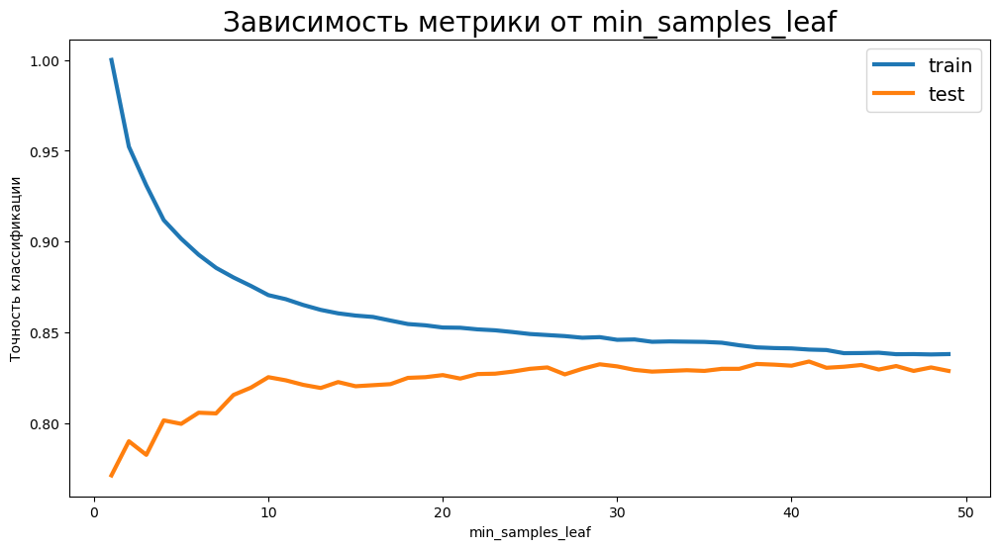

In [63]:
plot_dependence(
    'min_samples_leaf', range(1, 50), 
    title='Зависимость метрики от min_samples_leaf'
)

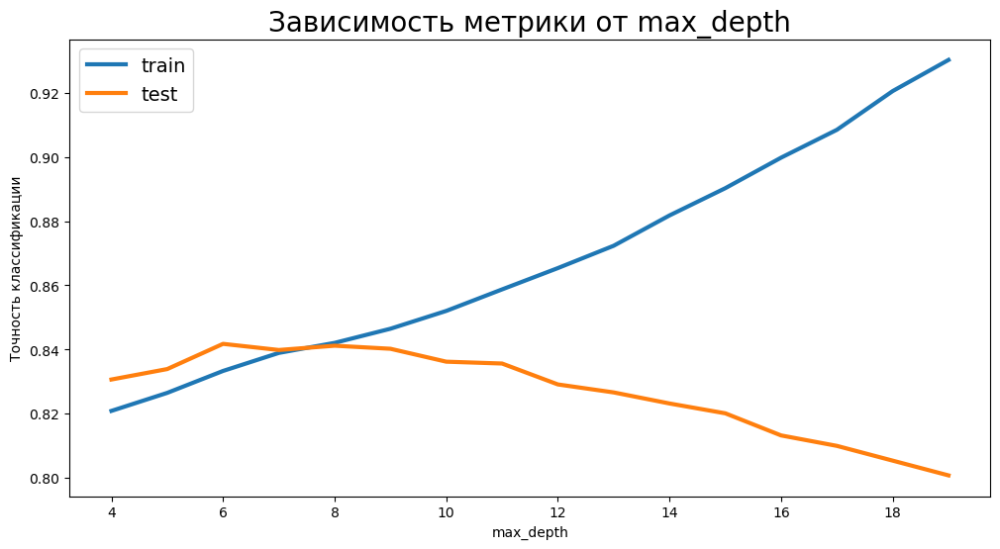

In [69]:
plot_dependence(
    'max_depth', range(4, 20), 
    title='Зависимость метрики от max_depth'
)

Получается до сих пор мы использовали CART по дефолту с методом GINI для создания точек разделения. Можем проделать тоже самое с энтропией

In [65]:
cl_tree_param_ent = DecisionTreeClassifier(criterion= "entropy", max_depth=4, random_state=42)
cl_tree_param_ent.fit(X_train, y_train)
print("Правильность на обучающем наборе: {:.3f}".format(cl_tree_param_ent.score(X_train,y_train)))
print("Правильность на тестовом наборе: {:.3f}".format(cl_tree_param_ent.score(X_test,y_test)))

Правильность на обучающем наборе: 0.814
Правильность на тестовом наборе: 0.826


In [66]:
from sklearn.metrics import accuracy_score, balanced_accuracy_score
predictions_param_ent = cl_tree_param_ent.predict(X_test)
accuracy_score(predictions_param_ent, y_test)

0.8256282370995588

In [67]:
accuracy_score(predictions_param, y_test)

0.8306157682716286

Видим, что с энтропией уровень классификации не стал лучше, чем в предыдущей модели.

Ну и попробуем сделать визуализацию

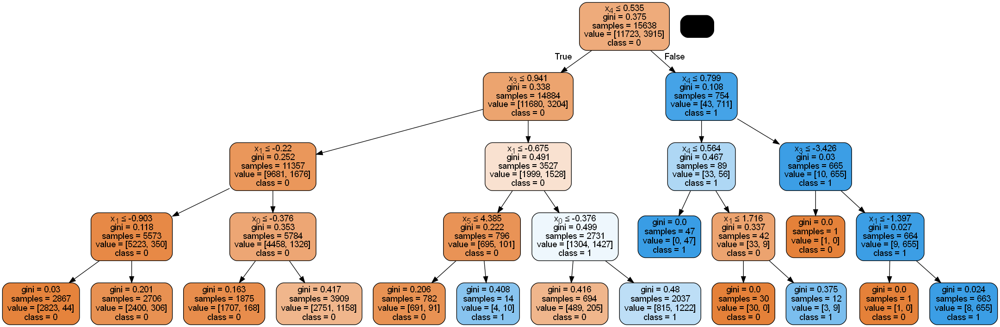

In [68]:
from six import StringIO 
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dot_data = StringIO()
export_graphviz(cl_tree_param, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names = None,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png('diabetes.png')
Image(graph.create_png())

In [76]:
from random import randint
from sklearn.model_selection import RandomizedSearchCV

param_dist = {'max_depth': [2,3,4,5,6,7,8,9,10,15,20]}

# Create a random forest classifier
rf = DecisionTreeClassifier()

# Use random search to find the best hyperparameters
rand_search = RandomizedSearchCV(rf, 
                                 param_distributions = param_dist, 
                                 n_iter=5, 
                                 cv=5)

# Fit the random search object to the data
rand_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5, estimator=DecisionTreeClassifier(), n_iter=5,
                   param_distributions={'max_depth': [2, 3, 4, 5, 6, 7, 8, 9,
                                                      10, 15, 20]})

In [77]:
# Create a variable for the best model
best_rf = rand_search.best_estimator_

# Print the best hyperparameters
print('Best hyperparameters:',  rand_search.best_params_)

Best hyperparameters: {'max_depth': 7}


По настройке гиперпараметров можем увидеть, что лучшее значение глубины варьируется от 7 до 10, поэтому я бы взяла глубину 8. Посмотрим теперь на точность с такой глубиной

In [80]:
cl_tree_param_ent = DecisionTreeClassifier(max_depth=8, random_state=42)
cl_tree_param_ent.fit(X_train, y_train)
print("Правильность на обучающем наборе: {:.3f}".format(cl_tree_param_ent.score(X_train,y_train)))
print("Правильность на тестовом наборе: {:.3f}".format(cl_tree_param_ent.score(X_test,y_test)))

Правильность на обучающем наборе: 0.842
Правильность на тестовом наборе: 0.841


## Случайный лес

In [81]:
from sklearn.ensemble import RandomForestClassifier

In [88]:
# Базовый вариант случайного леса
n_estimators = 100
rf = RandomForestClassifier(n_estimators=n_estimators)
rf.fit(X_train, y_train)

RandomForestClassifier()

In [83]:
from sklearn.metrics import accuracy_score, balanced_accuracy_score, precision_score, recall_score, confusion_matrix

In [89]:
y_pred = rf.predict(X_test)

print('Accuracy: ',accuracy_score(y_test, y_pred))

print('Precision: ', precision_score(y_test, y_pred))

print('Recall: ', recall_score(y_test, y_pred))

Accuracy:  0.8367542681757145
Precision:  0.7281795511221946
Recall:  0.4798685291700904


### Настройка гиперпараметров

В приведенном ниже коде используется RandomizedSearchCV, который будет случайным образом искать параметры в диапазоне для каждого гиперпараметра. Мы определяем используемые гиперпараметры и их диапазоны в словаре param_dist. 

In [85]:
from random import randint
from sklearn.model_selection import RandomizedSearchCV

param_dist = {'n_estimators': [20,30,45,50,100,200,500,800],
              'max_depth': [2,5,10,15,25,30]}

# Create a random forest classifier
rf = RandomForestClassifier()

# Use random search to find the best hyperparameters
rand_search = RandomizedSearchCV(rf, 
                                 param_distributions = param_dist, 
                                 n_iter=5, 
                                 cv=5)

# Fit the random search object to the data
rand_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5, estimator=RandomForestClassifier(), n_iter=5,
                   param_distributions={'max_depth': [2, 5, 10, 15, 25, 30],
                                        'n_estimators': [20, 30, 45, 50, 100,
                                                         200, 500, 800]})

In [86]:
# Create a variable for the best model
best_rf = rand_search.best_estimator_

# Print the best hyperparameters
print('Best hyperparameters:',  rand_search.best_params_)

Best hyperparameters: {'n_estimators': 500, 'max_depth': 10}


In [145]:
from sklearn.model_selection import GridSearchCV
n_estimators = [100, 300, 500, 800, 1200] 
max_depth = [5, 10, 15, 25, 30] 
min_samples_split = [2, 5, 10, 15, 100] 
min_samples_leaf = [1, 2, 5, 10] 

HyperF = dict(n_estimators = n_estimators, max_depth = max_depth,   
              min_samples_split = min_samples_split, 
             min_samples_leaf = min_samples_leaf) 

gridF = GridSearchCV(rf, HyperF, cv = 3, verbose = 1, 
                      n_jobs = -1) 
bestF = gridF.fit(X_train, y_train)

Fitting 3 folds for each of 500 candidates, totalling 1500 fits


In [148]:
# Create a variable for the best model
best_rf = bestF.best_estimator_

# Print the best hyperparameters
print('Best hyperparameters:',  bestF.best_params_)

Best hyperparameters: {'max_depth': 25, 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 500}


In [92]:
rf = RandomForestClassifier(n_estimators=500, max_depth = 10)
rf.fit(X_train, y_train)

RandomForestClassifier(max_depth=10, n_estimators=500)

In [93]:
y_pred = rf.predict(X_test)

print('Accuracy: ',accuracy_score(y_test, y_pred))

print('Precision: ', precision_score(y_test, y_pred))

print('Recall: ', recall_score(y_test, y_pred))

Accuracy:  0.8344523307116823
Precision:  0.8430232558139535
Recall:  0.3574363188167625


Сравним ещё с энтропией

In [100]:
rf = RandomForestClassifier(n_estimators=500, max_depth = 10, criterion = "entropy")
rf.fit(X_train, y_train)

RandomForestClassifier(criterion='entropy', max_depth=10, n_estimators=500)

In [101]:
y_pred = rf.predict(X_test)

print('Accuracy: ',accuracy_score(y_test, y_pred))

print('Precision: ', precision_score(y_test, y_pred))

print('Recall: ', recall_score(y_test, y_pred))

Accuracy:  0.8327258776136581
Precision:  0.8586278586278586
Recall:  0.33935907970419066


В случайных лесах энтропия лучше себя показала, чем в деревьях решений, но не уверена, что можно говорить, что эта модель лучше

In [97]:
# Cross-validation

from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold

rf = RandomForestClassifier(n_estimators=500, max_depth = 10)

fold = KFold(n_splits=5, shuffle=True, random_state=5)

scores = cross_val_score(estimator = rf,X=X_train, y=y_train,cv=fold)

In [98]:
print(scores)

[0.81841432 0.82992327 0.8193734  0.81771666 0.82826991]


In [99]:
print(scores.mean())

0.8227395132077107


In [23]:
# Split the data into features (X) and target (y)
X1 = data.drop(["y"],axis=1)
y1 = data.y
X1.head(5)

,sex,age_st,fnlwgt_st,education-num_st,capital-gain_st,capital-loss_st,hours-per-week_st,workclass_ Federal-gov,workclass_ Local-gov,workclass_ Private,...,native-country_ Portugal,native-country_ Puerto-Rico,native-country_ Scotland,native-country_ South,native-country_ Taiwan,native-country_ Thailand,native-country_ Trinadad&Tobago,native-country_ United-States,native-country_ Vietnam,native-country_ Yugoslavia
0,1,0.039556,-1.064446,1.135566,0.147504,-0.217055,-0.076483,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,1,0.873015,-1.009554,1.135566,-0.146708,-0.217055,-2.335254,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,1,-0.036213,0.243981,-0.443549,-0.146708,-0.217055,-0.076483,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,1,1.100322,0.424667,-1.233107,-0.146708,-0.217055,-0.076483,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
4,0,-0.793903,1.406845,1.135566,-0.146708,-0.217055,-0.076483,0.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


У меня не работала функция columns, поэтому я заново пробегусь по важным вещам, чтоб посмотреть важность признаков

In [24]:
from sklearn.model_selection import train_test_split

X_train1, X_test1, y_train1, y_test1 = train_test_split(X1, y1, test_size=0.25, random_state=42)

In [116]:
X_train1 = pd.DataFrame(X_train1, columns = X1.columns)
X_test1 = pd.DataFrame(X_test1, columns=X1.columns)

In [140]:
rf = RandomForestClassifier(n_estimators=500, max_depth = 10)
model = rf.fit(X_train1, y_train1)

In [119]:
# Важность признаков
feature_imp = pd.Series(rf.feature_importances_,index=list(X_train1.columns)).sort_values(ascending=False)
feature_imp

capital-gain_st                       0.261657
education-num_st                      0.200829
age_st                                0.176251
hours-per-week_st                     0.096784
capital-loss_st                       0.075644
                                        ...   
native-country_ Laos                  0.000046
native-country_ Ecuador               0.000037
native-country_ Honduras              0.000023
native-country_ Thailand              0.000018
native-country_ Holand-Netherlands    0.000000
Length: 103, dtype: float64

In [120]:
def plot_feature_importances_cancer(model):
    n_features = X_train.shape[1]
    plt.barh(range(n_features), model.feature_importances_, align='center')
    plt.yticks(np.arange(n_features), list(X_train.columns))
    plt.xlabel("Важность признака")
    plt.ylabel("Признак")

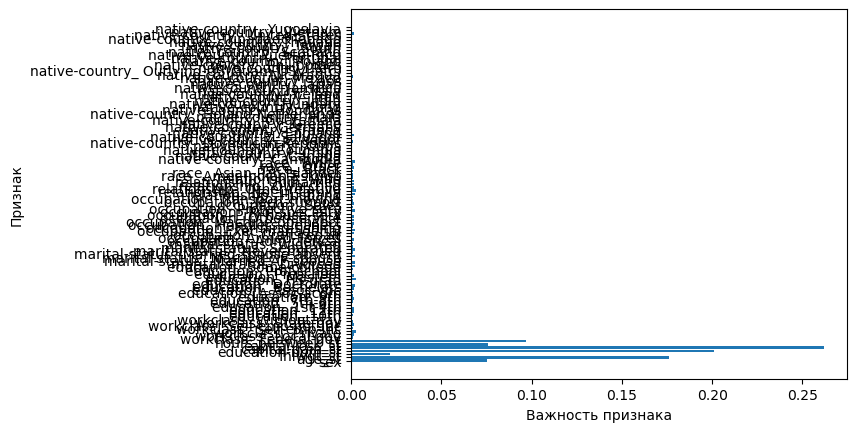

In [121]:
plot_feature_importances_cancer(rf)

In [122]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_selection import GenericUnivariateSelect, mutual_info_classif, SelectFromModel
from sklearn.pipeline import Pipeline
from sklearn.model_selection import StratifiedKFold, GridSearchCV, cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import PowerTransformer
from sklearn.linear_model import LogisticRegression

# зафиксируем значение генератора случайных чисел для воспроизводимости 
SEED = 1

# Функции, которые в дальнейшем понадобятся
def plot_features_scores(model, data, target, column_names, model_type):
    '''Функция для визуализации важности признаков'''
    
    model.fit(data, target)
    
    if model_type == 'rf':
        (pd.DataFrame(data={'score': model['rf'].feature_importances_}, 
                      index=column_names).sort_values(by='score')
                                         .plot(kind='barh', grid=True,
                                               figsize=(6,6), legend=False));

In [123]:
def grid_search(model, gs_params):
    '''Функция для подбора гиперпараметров с помощью перекрёстной проверки'''
     
    gs = GridSearchCV(estimator=model, param_grid=gs_params, refit=True,
                      scoring='roc_auc', n_jobs=-1, cv=skf, verbose=0)
    gs.fit(X1, y1)
    scores = [gs.cv_results_[f'split{i}_test_score'][gs.best_index_] for i in range(5)]
    print('scores = {}, \nmean score = {:.5f} +/- {:.5f} \
           \nbest params = {}'.format(scores,
                                      gs.cv_results_['mean_test_score'][gs.best_index_],
                                      gs.cv_results_['std_test_score'][gs.best_index_],
                                      gs.best_params_))
    return gs

scores = [0.85387973 0.85413241 0.84502753 0.8512044  0.85851141] 
mean score = 0.85255 +/- 0.00443


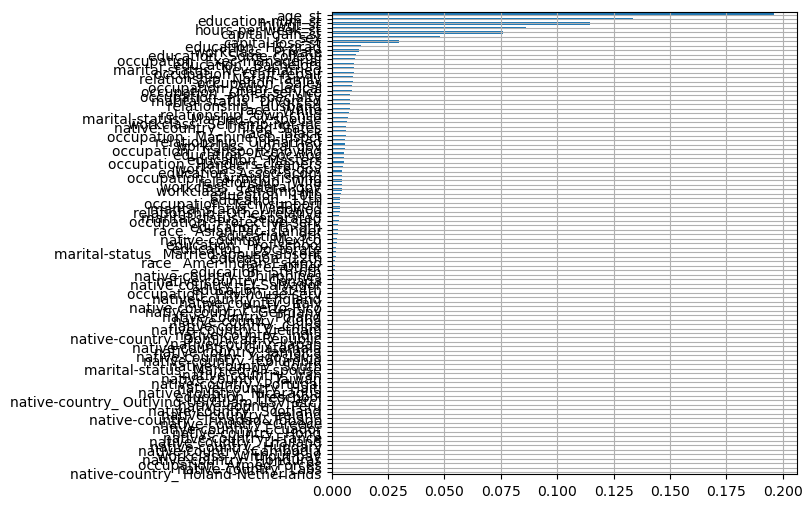

In [124]:
rf = Pipeline([('rf', RandomForestClassifier(n_jobs=-1, 
                                             class_weight='balanced', 
                                             random_state=SEED))])

# параметры кросс-валидации (стратифицированная 5-фолдовая с перемешиванием) 
skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=SEED)

scores = cross_val_score(estimator=rf, X=X1, y=y1, 
                         cv=skf, scoring='roc_auc', n_jobs=-1)
print('scores = {} \nmean score = {:.5f} +/- {:.5f}'.format(scores, scores.mean(), scores.std()))

# важность признаков
plot_features_scores(model=rf, data=X1, target=y1, column_names=X1.columns, model_type='rf')

In [125]:
selector = GenericUnivariateSelect(score_func=mutual_info_classif, 
                                   mode='k_best', 
                                   param=6)
# применим к нашему датасету
selector.fit(X1, y1)
# метод transform вернёт массив с отобранными признаками
# выведем результаты оценки каждого признака 
pd.DataFrame(data={'score':selector.scores_,
                   'support':selector.get_support()}, 
             index=X1.columns).sort_values(by='score',ascending=False)

,score,support
capital-gain_st,0.079931,True
age_st,0.064820,True
education-num_st,0.064352,True
hours-per-week_st,0.035159,True
capital-loss_st,0.034334,True
...,...,...
native-country_ Canada,0.000000,False
native-country_ Columbia,0.000000,False
native-country_ Cuba,0.000000,False
native-country_ Dominican-Republic,0.000000,False


In [127]:
# добавим селектор в пайплайн к случайному лесу
selector = ('selector', GenericUnivariateSelect(score_func=mutual_info_classif, 
                                                mode='k_best'))
rf.steps.insert(0, selector)

    
# grid search
rf_params = {'selector__param': np.arange(4,10),
             'rf__max_depth': np.arange(2, 16, 2),
             'rf__max_features': np.arange(0.3, 0.9, 0.2)}
print('grid search results for rf')
rf_grid = grid_search(model=rf, gs_params=rf_params)

grid search results for rf
scores = [0.8763405543951974, 0.8717915928852382, 0.863702296276456, 0.8648727239359354, 0.8740012348734967], 
mean score = 0.87014 +/- 0.00501            
best params = {'rf__max_depth': 14, 'rf__max_features': 0.3, 'selector__param': 6}


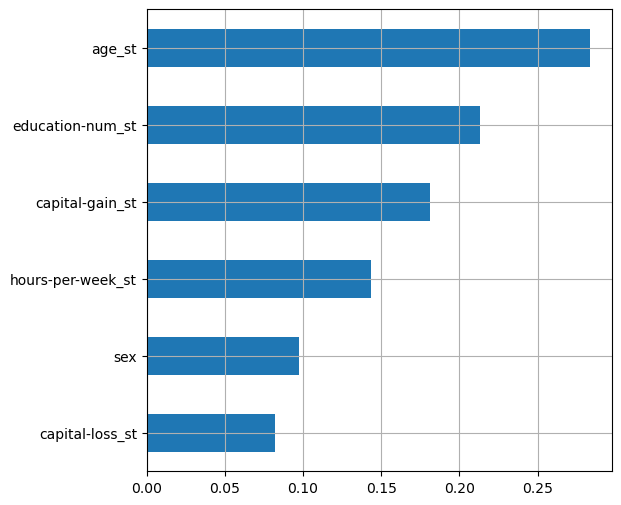

In [128]:
# выведем признаки, отобранные селектором
selected_features = [X1.columns[i] for i, support
                     in enumerate(rf_grid.best_estimator_['selector'].get_support()) if support]

plot_features_scores(model=rf_grid.best_estimator_, 
                     data=X1, target=y1, column_names=selected_features, model_type='rf')

In [129]:
cf_matrix = confusion_matrix(y_test, y_pred)
cf_matrix

array([[3928,   68],
       [ 804,  413]], dtype=int64)

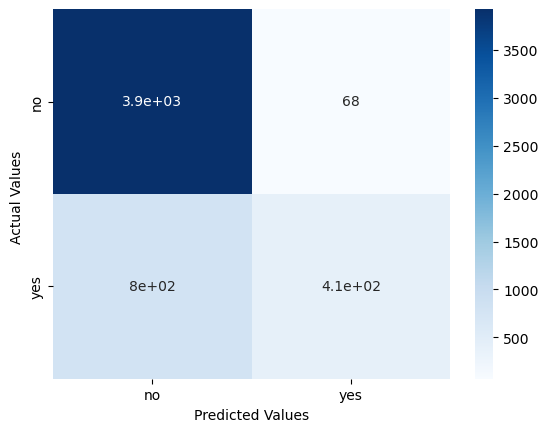

In [130]:
# Визуализация матрицы ошибок
import seaborn as sns

ax = sns.heatmap(cf_matrix, annot=True, cmap='Blues')

ax.set_xlabel('Predicted Values')
ax.set_ylabel('Actual Values ');

ax.xaxis.set_ticklabels(['no','yes'])
ax.yaxis.set_ticklabels(['no','yes'])


plt.show()

In [131]:
def get_train_and_test_accuracy(param_name, grid):
    '''
    Функция для оценки точности классификации 
    для заданных значений параметра param_name
    
    Параметры:
    1) param_name - название варьируемого параметра,
    2) grid - сетка значений параметра
    '''
        
    train_acc, test_acc = [], []
    
    for param_value in grid:
        estimator = RandomForestClassifier(**{param_name: param_value})
        estimator.fit(X_train, y_train)
        train_acc.append(accuracy_score(y_train, estimator.predict(X_train)))
        test_acc.append(accuracy_score(y_test, estimator.predict(X_test)))
    return train_acc, test_acc

In [132]:
def plot_dependence(param_name, grid=range(2, 20), title=''):
    '''
    Функция для отображения графика зависимости accuracy 
    от значения параметра c названием param_name
    
    Параметры:
    1) param_name - название параметра, который собираемся варьировать,
    2) grid - сетка значений параметра,
    3) title - заголовок графика
    '''
    
    plt.figure(figsize=(12, 6))
    
    train_acc, test_acc = get_train_and_test_accuracy(param_name, grid)
        
    plt.plot(grid, train_acc, label='train', lw=3)
    plt.plot(grid, test_acc, label='test', lw=3)
    plt.legend(fontsize=14)
    plt.xlabel(param_name)
    plt.ylabel('Точность классификации')
    plt.title(title, fontsize=20)
    plt.show()

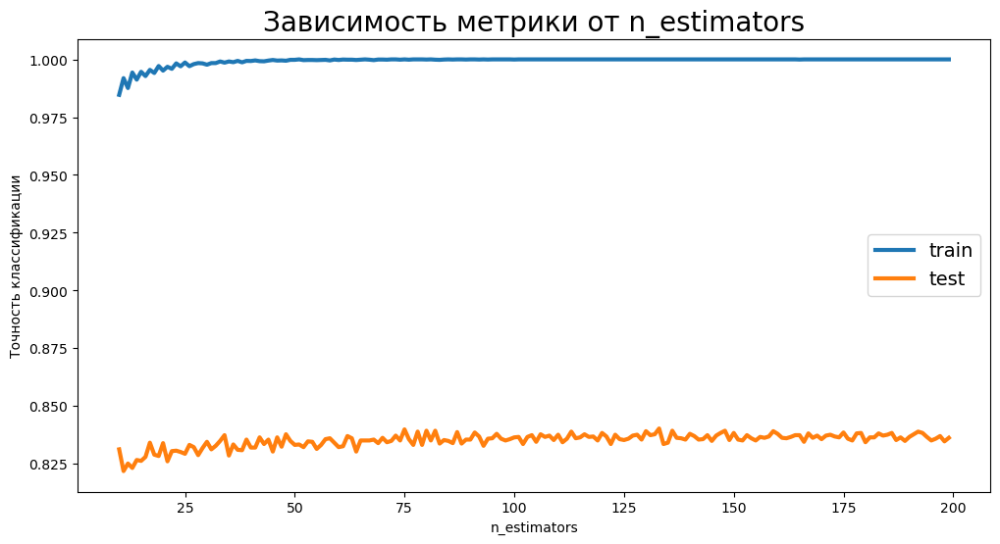

In [133]:
plot_dependence(
    'n_estimators', range(10, 200), 
    title='Зависимость метрики от n_estimators'
)

## LightGBM

In [156]:
pip install lightgbm

  Obtaining dependency information for lightgbm from https://files.pythonhosted.org/packages/b3/f8/ee33e36194eb03a76eccf3adac3fba51f0e56fbd20609bb531659d48d3cb/lightgbm-4.1.0-py3-none-win_amd64.whl.metadata
   ---------------------------------------- 0.0/1.3 MB ? eta -:--:--
   -- ------------------------------------- 0.1/1.3 MB 1.3 MB/s eta 0:00:01
   --- ------------------------------------ 0.1/1.3 MB 1.7 MB/s eta 0:00:01
   ------------- -------------------------- 0.4/1.3 MB 3.1 MB/s eta 0:00:01
   ------------------ --------------------- 0.6/1.3 MB 3.2 MB/s eta 0:00:01
   ----------------------- ---------------- 0.8/1.3 MB 3.2 MB/s eta 0:00:01
   --------------------------- ------------ 0.9/1.3 MB 3.2 MB/s eta 0:00:01
   ---------------------------- ----------- 0.9/1.3 MB 3.1 MB/s eta 0:00:01
   --------------------------------- ------ 1.1/1.3 MB 2.9 MB/s eta 0:00:01
   ----------------------------------- ---- 1.2/1.3 MB 2.7 MB/s eta 0:00:01
   -------------------------------------

In [42]:
from numpy import mean
from numpy import std
from sklearn.datasets import make_classification
from lightgbm import LGBMClassifier
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold

lgbm = LGBMClassifier()
lgbm.fit(X_train1,y_train1)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Number of positive: 3915, number of negative: 11723
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002766 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 713
[LightGBM] [Info] Number of data points in the train set: 15638, number of used features: 81
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.250352 -> initscore=-1.096737
[LightGBM] [Info] Start training from score -1.096737


LGBMClassifier()

In [43]:
from sklearn import metrics
print(metrics.classification_report(expected_y, y_pred))
print(metrics.confusion_matrix(expected_y, y_pred))

              precision    recall  f1-score   support

           0       0.87      0.95      0.91      3996
           1       0.77      0.53      0.63      1217

    accuracy                           0.85      5213
   macro avg       0.82      0.74      0.77      5213
weighted avg       0.85      0.85      0.84      5213

[[3801  195]
 [ 573  644]]


In [44]:
# Print the Confusion Matrix and slice it into four pieces

from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test1, y_pred)
print('Confusion matrix\n\n', cm)
print('\nTrue Positives(TP) = ', cm[0,0])
print('\nTrue Negatives(TN) = ', cm[1,1])
print('\nFalse Positives(FP) = ', cm[0,1])
print('\nFalse Negatives(FN) = ', cm[1,0])

Confusion matrix

 [[3801  195]
 [ 573  644]]

True Positives(TP) =  3801

True Negatives(TN) =  644

False Positives(FP) =  195

False Negatives(FN) =  573


In [46]:
from sklearn.metrics import accuracy_score, balanced_accuracy_score, precision_score, recall_score, confusion_matrix
y_pred = lgbm.predict(X_test1)

print('Accuracy: ',accuracy_score(y_test1, y_pred))

print('Precision: ', precision_score(y_test1, y_pred))

print('Recall: ', recall_score(y_test1, y_pred))

Accuracy:  0.8526760023019375
Precision:  0.767580452920143
Recall:  0.5291700903861956


In [50]:
lgbm = LGBMClassifier()
cv = RepeatedStratifiedKFold(n_splits=10,
                             n_repeats=3,
                             random_state=42)
n_scores = cross_val_score(lgbm, X_train1, y_train1, scoring='accuracy', cv=cv, n_jobs=-1, error_score='raise')
print('Точность: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

Точность: 0.842 (0.008)


In [56]:
# Параметры модели
num_leaves = 10 # Максимальное возможное значение 2^(max_depth)
min_data_in_leaf = 5
max_depth = 4

lgbm = LGBMClassifier(num_leaves=num_leaves,
                      min_data_in_leaf=min_data_in_leaf,
                      max_depth=max_depth)
lgbm.fit(X_train1,y_train1)

[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Info] Number of positive: 3915, number of negative: 11723
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 751
[LightGBM] [Info] Number of data points in the train set: 15638, number of used features: 100
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.250352 -> initscore=-1.096737
[LightGBM] [Info] Start training from score -1.096737


LGBMClassifier(max_depth=4, min_data_in_leaf=5, num_leaves=10)

In [57]:
y_pred = lgbm.predict(X_test1)

print('Accuracy: ',accuracy_score(y_test1, y_pred))

print('Precision: ', precision_score(y_test1, y_pred))

print('Recall: ', recall_score(y_test1, y_pred))

[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
Accuracy:  0.8549779397659697
Precision:  0.7906683480453972
Recall:  0.5152013147082991


In [52]:
cv = RepeatedStratifiedKFold(n_splits=10,
                             n_repeats=3,
                             random_state=42)
n_scores = cross_val_score(lgbm, X_train1, y_train1, scoring='accuracy', cv=cv, n_jobs=-1, error_score='raise')
print('Точность: %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

Точность: 0.841 (0.010)


In [58]:
from random import randint
from sklearn.model_selection import RandomizedSearchCV

param_dist = {'num_leaves': [10,15,20,30,45,50,60,70,80,90],
              'max_depth': [2,5,10,15,25,30],
              'min_data_in_leaf': [2,5,6,7,8,9,10]}

lgbm = LGBMClassifier()

# Use random search to find the best hyperparameters
rand_search = RandomizedSearchCV(lgbm, 
                                 param_distributions = param_dist, 
                                 n_iter=5, 
                                 cv=5)

# Fit the random search object to the data
rand_search.fit(X_train1, y_train1)

[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[LightGBM] [Info] Number of positive: 3132, number of negative: 9378
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002632 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 711
[LightGBM] [Info] Number of data points in the train set: 12510, number of used features: 88
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.250360 -> initscore=-1.096695
[LightGBM] [Info] Start training from score -1.096695
[LightGBM] [Warning] min_data_in_leaf is set=9, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=9
[Ligh

[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=5, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=5
[LightGBM] [Info] Number of positive: 3132, number of negative: 9379
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002573 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 737
[LightGBM] [Info] Number of data points in the train set: 12511, number of used features: 100
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.250340 -> initscore=-1.096801
[LightGBM] [Info] Start training from score -1.096801
[Lig

[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=7, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=7
[LightGBM] [Info] Number of positive: 3132, number of negative: 9379
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002247 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 718
[LightGBM] [Info] Number of data points in the train set: 12511, number of used features: 93
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.250340 -> initscore=-1.096801
[LightGBM] [Info] Start training from score -1.096801
[Ligh

RandomizedSearchCV(cv=5, estimator=LGBMClassifier(), n_iter=5,
                   param_distributions={'max_depth': [2, 5, 10, 15, 25, 30],
                                        'min_data_in_leaf': [2, 5, 6, 7, 8, 9,
                                                             10],
                                        'num_leaves': [10, 15, 20, 30, 45, 50,
                                                       60, 70, 80, 90]})

In [59]:
# Create a variable for the best model
best_lgbm = rand_search.best_estimator_

# Print the best hyperparameters
print('Best hyperparameters:',  rand_search.best_params_)

Best hyperparameters: {'num_leaves': 30, 'min_data_in_leaf': 5, 'max_depth': 25}


In [62]:
#grid of parameters
gridParams = {
    'learning_rate': [0.05],
    'num_leaves': [90,200],
    'boosting_type' : ['gbdt'],
    'objective' : ['binary'],
    'max_depth' : [5,6,7,8],
    'random_state' : [501], 
    'colsample_bytree' : [0.5,0.7],
    'subsample' : [0.5,0.7],
    'min_split_gain' : [0.01],
    'min_data_in_leaf':[10],
    'metric':['auc']
    }

In [63]:
#modelling
lgbm = LGBMClassifier()
grid = RandomizedSearchCV(lgbm,gridParams,verbose=1,cv=10,n_jobs = -1,n_iter=10)
grid.fit(X_train1,y_train1)

Fitting 10 folds for each of 10 candidates, totalling 100 fits
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Info] Number of positive: 3915, number of negative: 11723
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002363 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 733
[LightGBM] [Info] Number of data points in the train set: 15638, number of used features: 91
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.250352 -> initscore=-1.096737
[LightGBM] [Info] Start training from score -1.096737
[LightGBM] [Warning] No further splits with positive gain

RandomizedSearchCV(cv=10, estimator=LGBMClassifier(), n_jobs=-1,
                   param_distributions={'boosting_type': ['gbdt'],
                                        'colsample_bytree': [0.5, 0.7],
                                        'learning_rate': [0.05],
                                        'max_depth': [5, 6, 7, 8],
                                        'metric': ['auc'],
                                        'min_data_in_leaf': [10],
                                        'min_split_gain': [0.01],
                                        'num_leaves': [90, 200],
                                        'objective': ['binary'],
                                        'random_state': [501],
                                        'subsample': [0.5, 0.7]},
                   verbose=1)

In [64]:
#best parameters
grid.best_params_

{'subsample': 0.7,
 'random_state': 501,
 'objective': 'binary',
 'num_leaves': 90,
 'min_split_gain': 0.01,
 'min_data_in_leaf': 10,
 'metric': 'auc',
 'max_depth': 8,
 'learning_rate': 0.05,
 'colsample_bytree': 0.5,
 'boosting_type': 'gbdt'}

In [68]:
#Prediction
y_pred = grid.predict(X_test1)

[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10


In [69]:
#auc calculation
metrics.roc_auc_score(y_test1,y_pred)

0.7317578465893997

In [65]:
num_leaves = 90 
min_data_in_leaf = 10
max_depth = 8

lgbm = LGBMClassifier(num_leaves=num_leaves,
                      min_data_in_leaf=min_data_in_leaf,
                      max_depth=max_depth)
lgbm.fit(X_train1,y_train1)

[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
[LightGBM] [Info] Number of positive: 3915, number of negative: 11723
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004325 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 733
[LightGBM] [Info] Number of data points in the train set: 15638, number of used features: 91
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.250352 -> initscore=-1.096737
[LightGBM] [Info] Start training from score -1.096737
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with p

LGBMClassifier(max_depth=8, min_data_in_leaf=10, num_leaves=90)

In [66]:
y_pred = lgbm.predict(X_test1)

print('Accuracy: ',accuracy_score(y_test1, y_pred))

print('Precision: ', precision_score(y_test1, y_pred))

print('Recall: ', recall_score(y_test1, y_pred))

[LightGBM] [Warning] min_data_in_leaf is set=10, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=10
Accuracy:  0.8501822367159025
Precision:  0.7652068126520681
Recall:  0.5168447000821693


## SHAP values

In [134]:
pip install shap


  Obtaining dependency information for shap from https://files.pythonhosted.org/packages/f5/fc/e81722d6bec4fcba46e46ef895eddaeab0027ac71e78fc35ef351fac5fe4/shap-0.43.0-cp311-cp311-win_amd64.whl.metadata
   ---------------------------------------- 0.0/447.3 kB ? eta -:--:--
   ----- ---------------------------------- 61.4/447.3 kB 1.6 MB/s eta 0:00:01
   ----------------- ---------------------- 194.6/447.3 kB 2.9 MB/s eta 0:00:01
   ------------------------- -------------- 286.7/447.3 kB 2.2 MB/s eta 0:00:01
   ----------------------------------- ---- 399.4/447.3 kB 2.3 MB/s eta 0:00:01
   ---------------------------------------- 447.3/447.3 kB 2.1 MB/s eta 0:00:00


In [70]:
import shap

In [71]:
explainer = shap.Explainer(lgbm)
shap_values = explainer.shap_values(X_test1)

LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray


### Важность переменных

Сводный график показывает важность каждой функции в модели. 

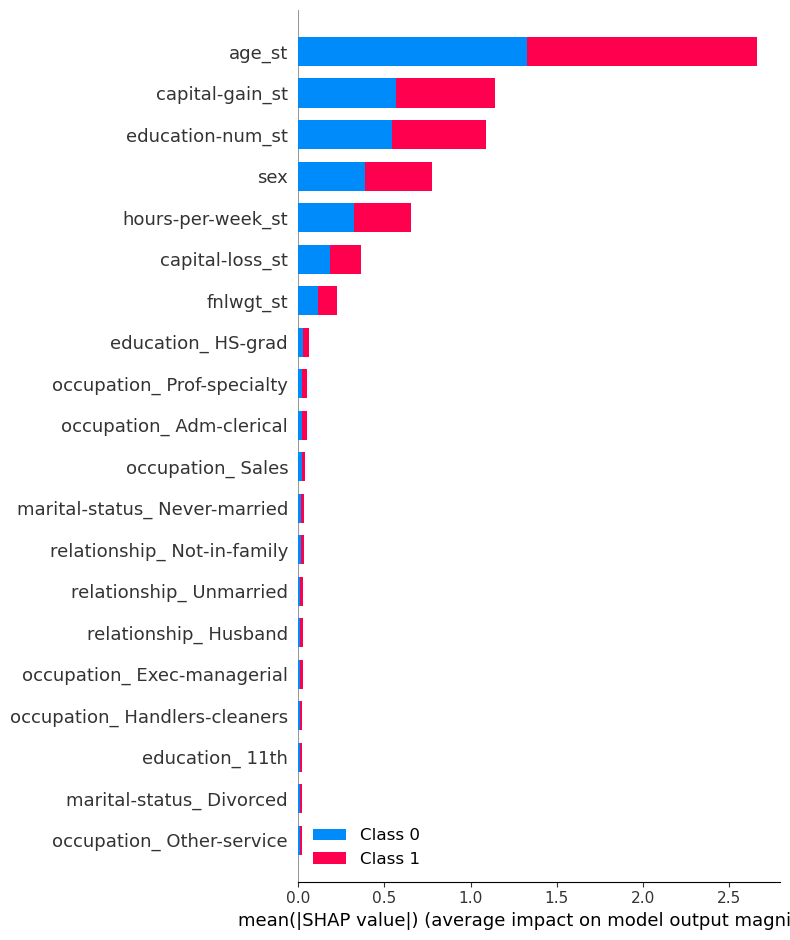

In [72]:
shap.summary_plot(shap_values, X_test1)

Результаты показывают, что образование, возраст, пол, прирост капитала, часы в неделю играют важную роль в определении результата. Теперь посмотрим на другой график

Ось Y указывает названия функций в порядке важности сверху вниз.
Ось X представляет значение SHAP, которое указывает степень изменения логарифмических шансов.
Цвет каждой точки на графике представляет значение соответствующего признака: красный цвет указывает на высокие значения, а синий — на низкие значения .
Каждая точка представляет собой строку данных из исходного набора данных.

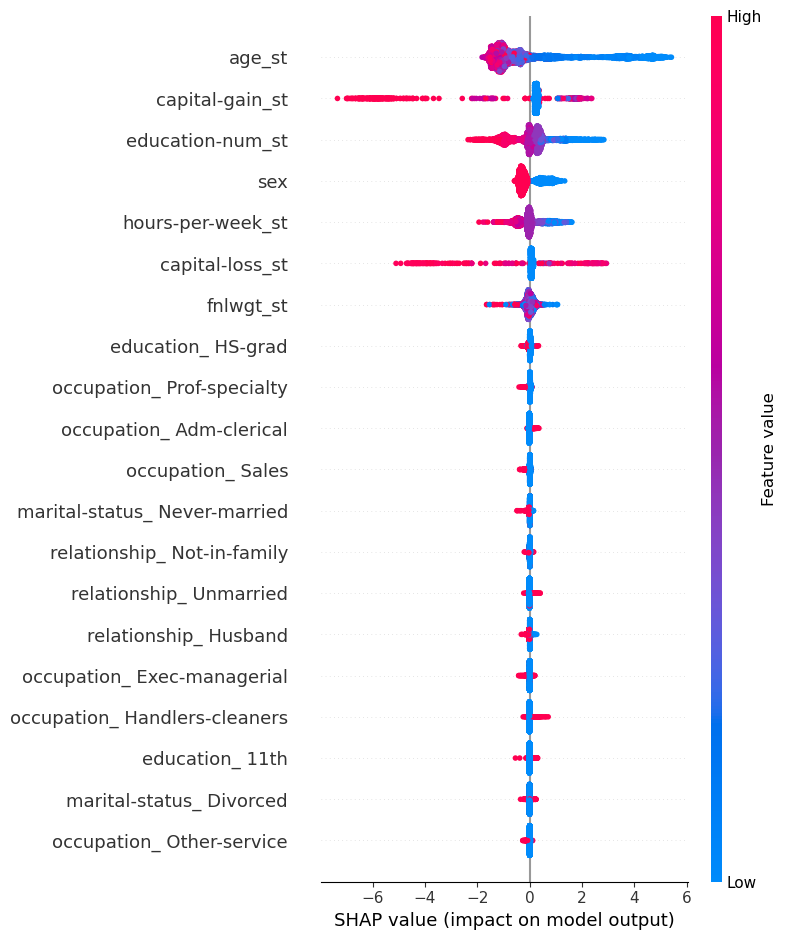

In [73]:
shap.summary_plot(shap_values[0], X_test1)

Видим, что у прироста капитала в основном высокие с отрицательным значением Shap. Возраст чем меньше, тем положительнее влияет на резульат. У мужчин ниже вероятность иметь большой капитал. Чем больше количество лет образования и ставки(часы в неделю), тем ниже значение Shap.

График зависимости — это тип диаграммы рассеяния, которая показывает, как на прогнозы модели влияет конкретная функция (количество лет обучения). 

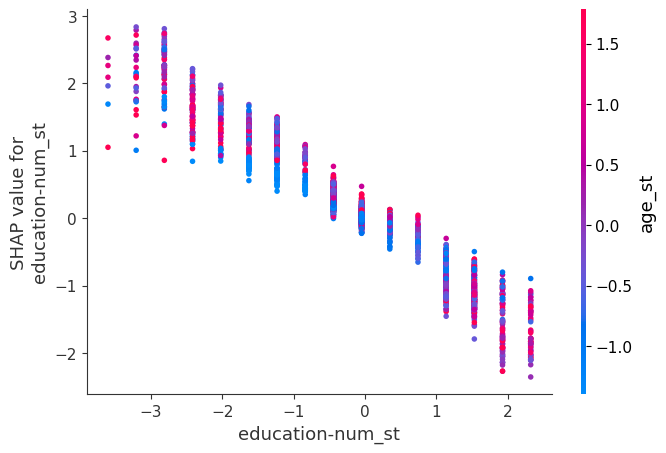

In [74]:
shap.dependence_plot("education-num_st", shap_values[0], X_test1,interaction_index="age_st")

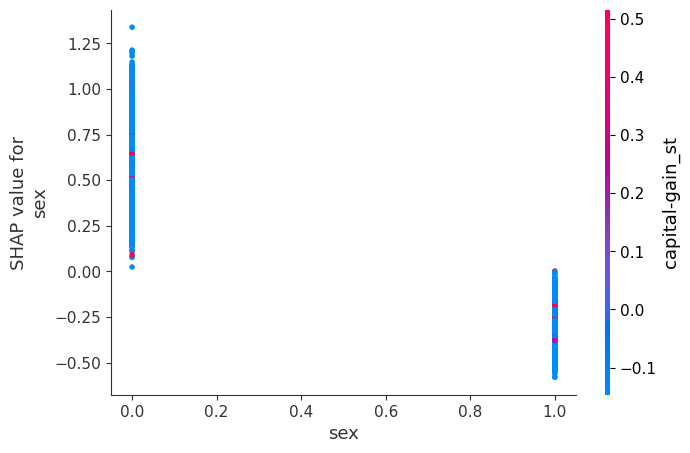

In [75]:
shap.dependence_plot("sex", shap_values[0], X_test1,interaction_index="capital-gain_st")

На наличие капитала более 50К негативно влияет пол, в данном случае мужчины и возраст

### Графики силы влияния

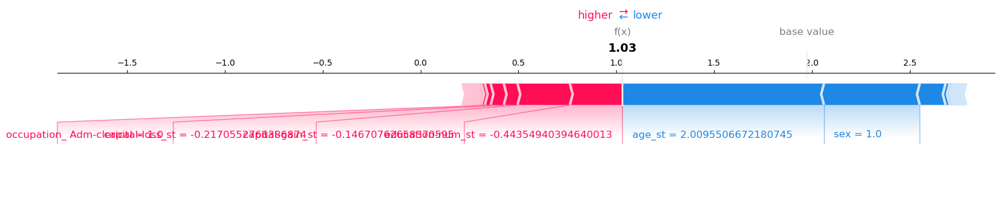

In [76]:
shap.plots.force(explainer.expected_value[0], shap_values[0][0,:], X_test1.iloc[0, :], matplotlib = True)

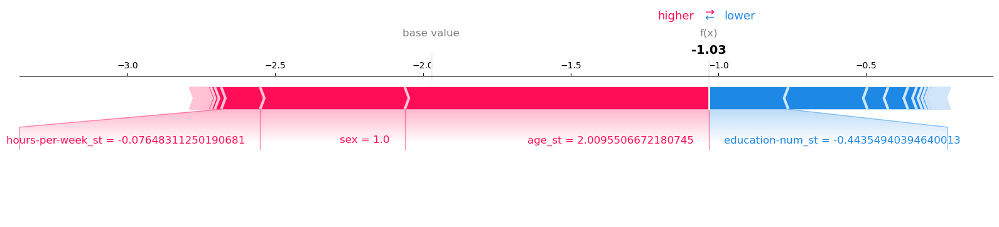

In [77]:
shap.plots.force(explainer.expected_value[1], shap_values[1][0,:], X_test1.iloc[0, :], matplotlib = True)

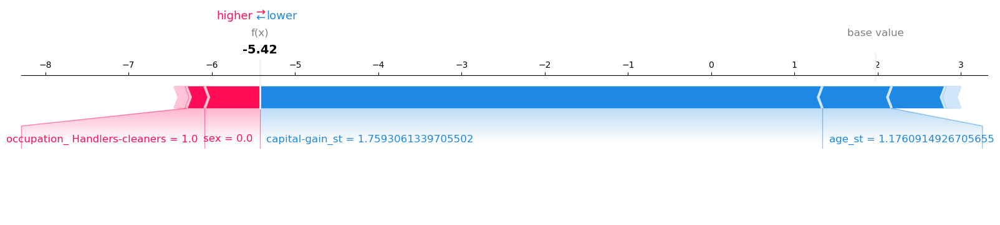

In [78]:
shap.plots.force(explainer.expected_value[0], shap_values[0][10,:], X_test1.iloc[10, :], matplotlib = True)

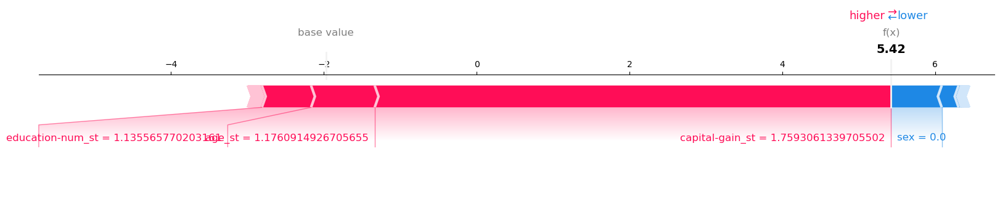

In [79]:
shap.plots.force(explainer.expected_value[1], shap_values[1][10,:], X_test1.iloc[10, :], matplotlib = True)

### Графики принятия решений

Каждая линия на графике решения показывает, насколько сильно отдельные функции способствовали прогнозу одной модели, тем самым объясняя, какие значения функций повлияли на прогноз.

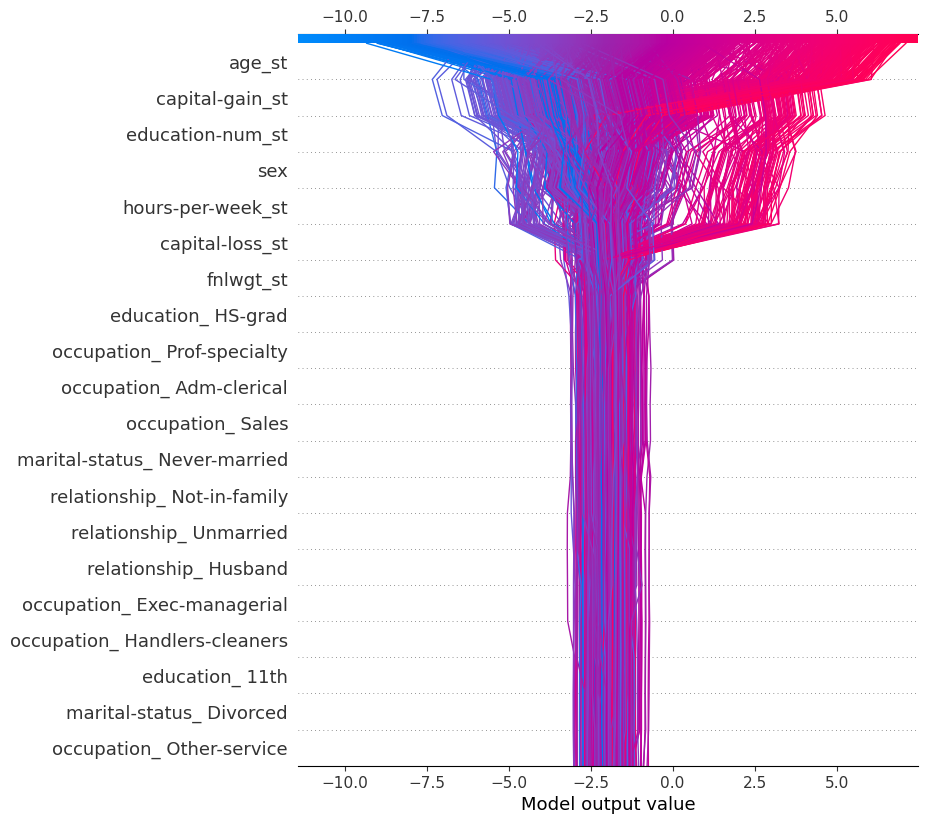

In [80]:
shap.decision_plot(explainer.expected_value[1], shap_values[1], X_test1.columns, ignore_warnings = True)

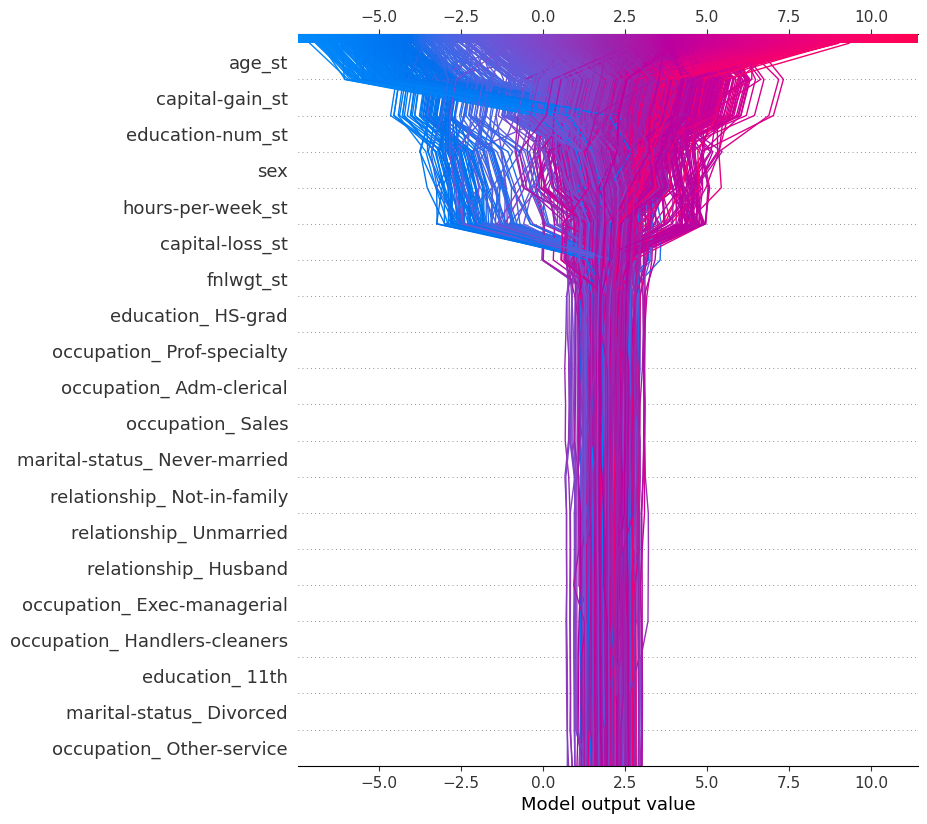

In [81]:
shap.decision_plot(explainer.expected_value[0], shap_values[0], X_test1.columns, ignore_warnings=True)